*UID*:118979748 120380389 118782928 118895499

Using two free late days


# **CMSC426 Project 2: Panorama Stitching**

# Introduction

The aim of this project is to implement an end-to-end pipeline for panorama stitching. We all use the panorama mode on our smart-phones– you’ll implement a pipeline which does the same basic thing!

This document just provides an overview of what you need to do. For a full breakdown of how each step in the pipeline works, see the [course notes](https://cmsc426.github.io/pano/) for this project.

# System Overview
Here’s a system diagram, showing each step in your panorama-stitching pipeline:
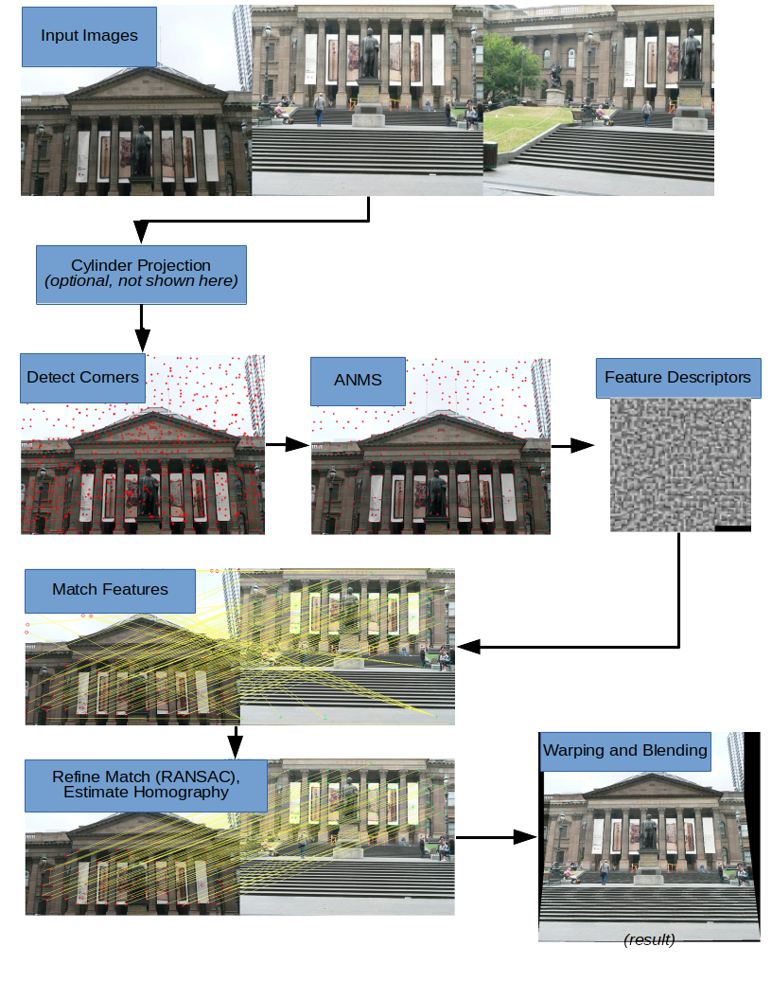







In [121]:
# Download training images from Google Drive
import gdown
#gdown.download_folder(id="1VAB_BG2gntlkwR059zR_8gd9pXajzgIk", quiet=True, use_cookies=False)

In [122]:
gdown.download_folder(id="1U0UxiS3N_25aTd7WxDekug14WDpIXcZX", quiet=True, use_cookies=False)


#https://drive.google.com/drive/folders/1U0UxiS3N_25aTd7WxDekug14WDpIXcZX?usp=drive_link

['/content/test_images/TestSet1/1.jpg',
 '/content/test_images/TestSet1/2.jpg',
 '/content/test_images/TestSet1/3.jpg',
 '/content/test_images/TestSet1/4.jpg',
 '/content/test_images/TestSet2/1.jpg',
 '/content/test_images/TestSet2/2.jpg',
 '/content/test_images/TestSet2/3.jpg',
 '/content/test_images/TestSet2/4.jpg',
 '/content/test_images/TestSet2/5.jpg',
 '/content/test_images/TestSet2/6.jpg',
 '/content/test_images/TestSet2/7.jpg',
 '/content/test_images/TestSet2/8.jpg',
 '/content/test_images/TestSet2/9.jpg',
 '/content/test_images/TestSet3/1.jpg',
 '/content/test_images/TestSet3/2.jpg',
 '/content/test_images/TestSet3/3.jpg']

(0.0, 1.0, 0.0, 1.0)

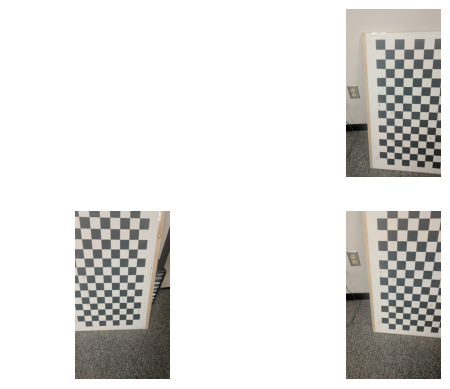

In [126]:
# Check whether the training images were successfully imported
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

test_image = mpimg.imread('/content/test_images/TestSet1/1.jpg')
test_image2 = mpimg.imread('/content/test_images/TestSet1/2.jpg')
test_image3 = mpimg.imread('/content/test_images/TestSet1/3.jpg')
f, a = plt.subplots(2, 2)

a[0][1].imshow(test_image)
a[0][1].axis("off")
a[1][1].imshow(test_image2)
a[1][1].axis("off")
a[1][0].imshow(test_image3)
a[1][0].axis("off")
a[0][0].axis("off")

(0.0, 1.0, 0.0, 1.0)

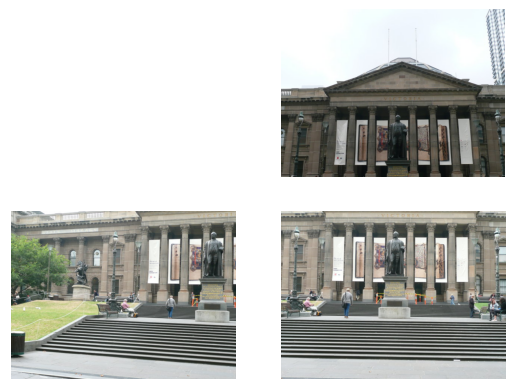

In [ ]:
# Check whether the training images were successfully imported
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np

train_image = mpimg.imread('/content/train_images/Set1/1.jpg')
train_image2 = mpimg.imread('/content/train_images/Set1/2.jpg')
train_image3 = mpimg.imread('/content/train_images/Set1/3.jpg')
f, a = plt.subplots(2, 2)

a[0][1].imshow(train_image)
a[0][1].axis("off")
a[1][1].imshow(train_image2)
a[1][1].axis("off")
a[1][0].imshow(train_image3)
a[1][0].axis("off")
a[0][0].axis("off")

## Problem Statement

### 1. Detect Corners and Adaptive Non-Maximal Suppression (or ANMS) [25 points]


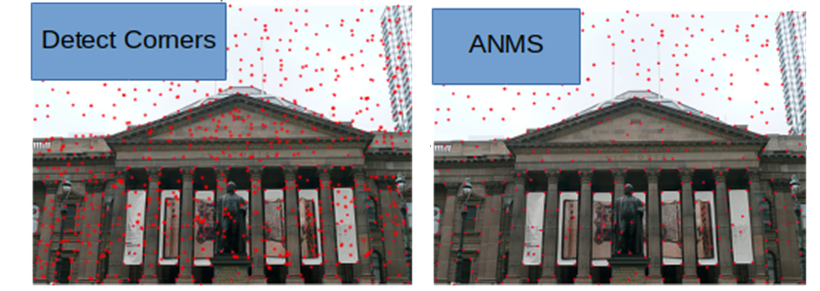

#### Step 1: Corner Detection

The first step in stitching a panorama is extracting corners like most computer vision tasks. Here we will use either Harris corners or Shi-Tomasi corners. Use **cv2.cornerHarris** or **cv2.goodFeaturesToTrack** to implement this part.


In [159]:
### Corner Detection
# 1) Convert image to gray scale image
# 2) Run harris or other corner detection from cv2 (cv2.cornerHarris OR cv2.goodFeaturesToTrack, etc.)
# Show the corner detection results for one image!!!

import cv2
THRESH = 0.01
def harris(img, thresh=THRESH, limit=5000):
  img_corn = img.copy()

  grey = getGreyImage(img)
  dst = cv2.cornerHarris(grey,2,3,0.04)
  dst = cv2.dilate(dst,None)

  for i in range(8):
    corners = np.argwhere(dst > thresh * dst.max())
    if len(corners)<limit:
      break
    thresh = thresh*1.5

  img_corn[corners[:, 0], corners[:, 1]]=[0,0,255]

  return img_corn, grey, corners[:, [1, 0]]


def detect_corner(img):
  img_corn = img.copy()
  grey = getGreyImage(img)

  corn = np.intp(cv2.goodFeaturesToTrack(grey, 10000, 0.01, 20))

  for i in corn:
    x, y = i.ravel()
    cv2.circle(img_corn, (x, y), 3, 255, -1)

  return img_corn, grey, corn.reshape(-1, 2)

def getGreyImage(img):
  return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [ ]:
# Show you result here
THRESH = 0.01

# harris(train_image, THRESH)[0]
f, a = plt.subplots(1, 2, figsize=(12, 6))
a[0].imshow(harris(test_image)[0])
a[0].axis('off')
#a[1].imshow(detect_corner(test_image)[0])
a[1].axis('off')

(-0.5, 599.5, 449.5, -0.5)

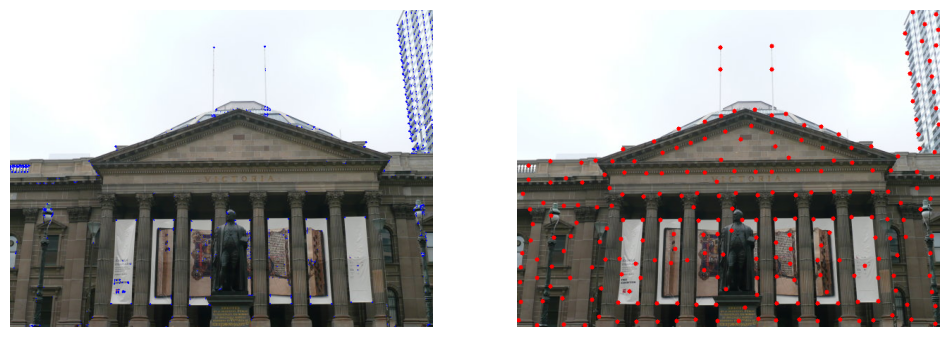

In [ ]:
# Show you result here
THRESH = 0.01

# harris(train_image, THRESH)[0]
f, a = plt.subplots(1, 2, figsize=(12, 6))
a[0].imshow(harris(train_image)[0])
a[0].axis('off')
a[1].imshow(detect_corner(train_image)[0])
a[1].axis('off')

#### Step 2: Adaptive Non-Maximal Suppression (or ANMS)

The objective of this step is to detect corners such that they are equally distributed across the image in order to avoid weird artifacts in warping.

In a real image, a corner is never perfectly sharp, each corner might get a lot of hits out of the **N**
 strong corners - we want to choose only the **$N_{best}$**
 best corners after ANMS. In essence, you will get a lot more corners than you should! ANMS will try to find corners which are true local maxima. The algorithm for implementing ANMS is given below.



In [ ]:
### Adaptive Non-Maximal Suppression (or ANMS)
# Perform ANMS: Adaptive Non-Maximal Suppression
# Show ANMS output as an image

from google.colab.patches import cv2_imshow

def ANMS(cmap, corners, num_best):
    # List of radii where each corner is suppressed
    radii = np.full(len(corners), np.inf)

    # Loop over all corners
    for i, (x1, y1) in enumerate(corners):
        # Get the strength of the current corner from the corner map
        current_strength = cmap[y1, x1]

        # Compare with all other corners
        for j, (x2, y2) in enumerate(corners):
            # Get the strength of the other corner
            if cmap[y2, x2] > current_strength:
                # Calculate the distance between the two corners
                distance = np.sqrt((x1 - x2)**2 + (y1 - y2)**2)

                # Suppress if the other corner is stronger
                radii[i] = min(radii[i], distance)

    # Sort the corners by the largest radii and select the best ones
    sorted_indices = np.argsort(-radii)
    best_corners = [corners[i] for i in sorted_indices[:num_best]]

    return best_corners


def visualize_ANMS(image, best_corners):
    img_anms = image.copy()

    # Draw green circles at the best corners
    for (x, y) in best_corners:
        cv2.circle(img_anms, (x, y), radius=3, color=(0, 255, 0), thickness=-1)

    # Use cv2_imshow to display the image in Colab
    cv2_imshow(img_anms)


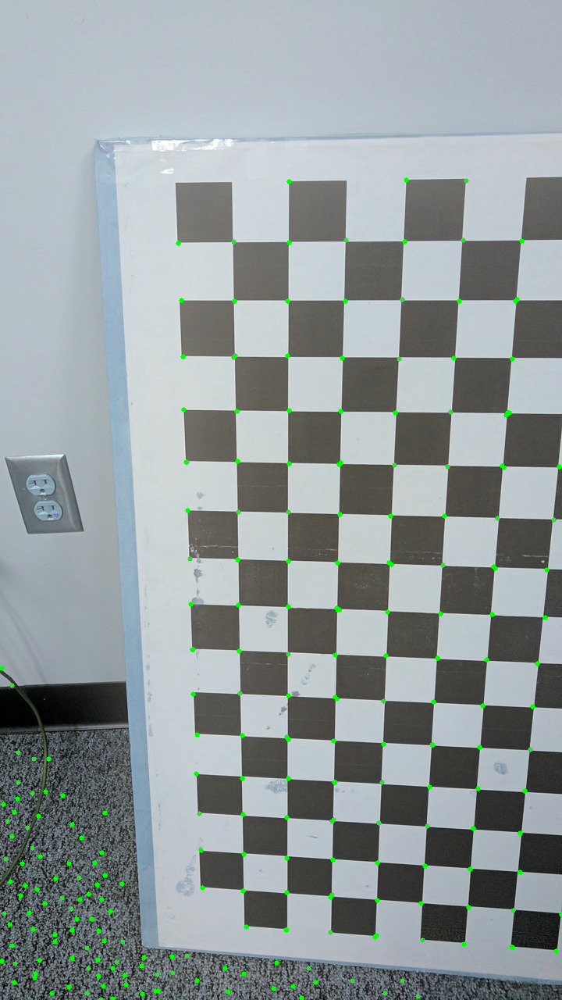

'\n# Show you result here\nimg_corn, grey, corners = harris(train_image)\nbest_corners = ANMS(grey, corners, num_best= 250)\nimg_corn2, grey2, corners2 = harris(train_image2)\nbest_corners2 = ANMS(grey2, corners2, num_best= 250)\nimg_corn3, grey3, corners3 = harris(train_image3)\nbest_corners3 = ANMS(grey3, corners3, num_best= 250)\n\nvisualize_ANMS(train_image, best_corners)\nvisualize_ANMS(train_image2, best_corners2)\nvisualize_ANMS(train_image3, best_corners3)\n'

In [139]:
# Show you result here
#img_corn, grey, corners = detect_corner(train_image)
#best_corners = ANMS(grey, corners, num_best= 150)
#visualize_ANMS(train_image, best_corners)

'''
img_corn, grey, corners = harris(test_image)
best_corners = ANMS(grey, corners, num_best= 250)
visualize_ANMS(test_image, best_corners)
'''
# Show you result here
img_corn, grey, corners = harris(train_image)
best_corners = ANMS(grey, corners, num_best= 250)
img_corn2, grey2, corners2 = harris(train_image2)
best_corners2 = ANMS(grey2, corners2, num_best= 250)
img_corn3, grey3, corners3 = harris(train_image3)
best_corners3 = ANMS(grey3, corners3, num_best= 250)

visualize_ANMS(train_image, best_corners)
visualize_ANMS(train_image2, best_corners2)
visualize_ANMS(train_image3, best_corners3)


### 2. Feature Descriptors: [15pts]

In the previous step, you found the feature points (locations of the Nbest
 best corners after ANMS are called the feature point locations). You need to describe each feature point by a feature vector, this is like encoding the information at each feature point by a vector. One of the easiest feature descriptor is described next.

Take a patch of **size 40×40**
 centered **(this is very important**) around the keypoint/feature point. Now apply gaussian blur (feel free to play around with the parameters, for a start you can use OpenCV’s default parameters in **cv2.GaussianBlur** command. Now, sub-sample the blurred output (this reduces the dimension) to 8×8
. Then reshape to obtain a 64×1
 vector. Standardize the vector to have zero mean and variance of 1. Standardization is used to remove bias and to achieve some amount of illumination invariance.

In [ ]:
### Generate feature Descriptor for corners
def feature_descript(gray_img, corners, show=False):
  desc = []
  for x, y in corners:
    patch = gray_img[max(0, y-20):min(len(gray_img), y+20), max(0, x-20):min(len(gray_img[0]), x+20)]
    padded = np.pad(patch, ((0, 40 - patch.shape[0]), (0, 40 - patch.shape[1])), mode='reflect')

    blurred = cv2.GaussianBlur(padded, (5, 5), 3)
    sampled = blurred[::5, ::5]
    reshaped = sampled.reshape(64)
    standardized = (reshaped - reshaped.mean()) / reshaped.std()

    desc.append(standardized)

  if show:
    plt.imshow(padded, cmap='gray')
    plt.show()
    plt.imshow(blurred, cmap='gray')
    plt.show()
    plt.imshow(sampled, cmap='gray')
    plt.show()
    plt.imshow(reshaped.reshape(1, 64), cmap='gray')

  return desc

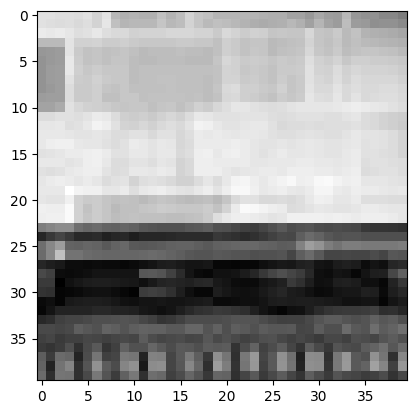

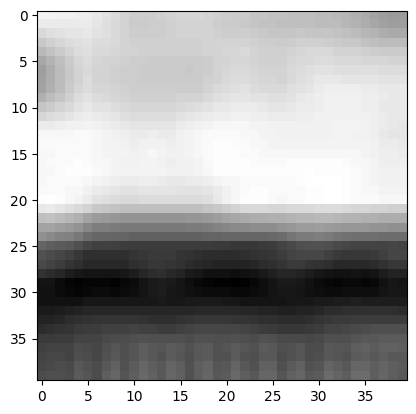

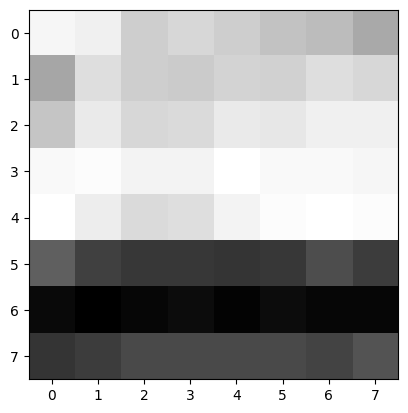

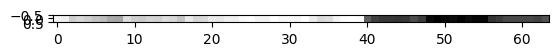

In [ ]:
# Show you result here
corners = detect_corner(train_image)
feat = feature_descript(corners[1], corners[2], True)

### 3. Feature Matching: [15pts]

In the previous step, you encoded each keypoint by **64×1**
 feature vector. Now, you want to match the feature points among the two images you want to stitch together. In computer vision terms, this step is called as finding feature correspondences between the 2 images. Pick a point in image 1, compute sum of square differences between all points in image 2. Take the ratio of best match (lowest distance) to the second best match (second lowest distance) and if this is below some ratio keep the matched pair or reject it. Repeat this for all points in image 1. You will be left with only the confident feature correspondences and these points will be used to estimate the transformation between the 2 images, also called as Homography. Use the function **cv2.drawMatches** to visualize feature correspondences. Below is an image showing matched features.



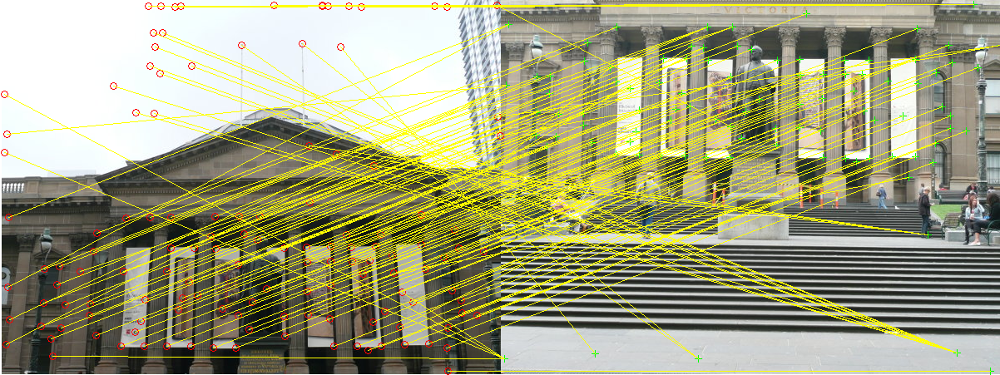

In [150]:
### Feature matching
def feature_match(img1, img2, corner1, corner2, THRESH):
  matches = []
  i = 0
  for c1 in corner1:
    dists = [np.sum((c2 - c1)**2) for c2 in corner2]
    sorted = np.sort(dists)
    if sorted[0] / sorted[1] < THRESH:
      matches.append((i,dists.index(sorted[0])))
    i=i+1
  return matches

[(10, 6), (11, 0), (13, 80), (15, 14), (16, 84), (19, 10), (22, 4), (24, 69), (28, 22), (29, 23), (31, 85), (32, 74), (34, 75), (35, 86), (39, 80), (41, 181), (45, 29), (46, 21), (47, 78), (51, 52), (52, 109), (53, 91), (55, 224), (57, 65), (58, 164), (60, 77), (61, 72), (62, 64), (63, 66), (65, 48), (67, 82), (68, 76), (70, 167), (72, 15), (73, 63), (74, 215), (75, 15), (76, 88), (77, 70), (79, 205), (80, 71), (81, 8), (83, 91), (84, 222), (85, 222), (90, 96), (97, 114), (99, 64), (101, 92), (106, 150), (108, 65), (109, 57), (110, 206), (112, 151), (115, 130), (116, 206), (117, 133), (120, 141), (121, 195), (123, 147), (124, 142), (127, 140), (128, 29), (133, 145), (134, 146), (135, 202), (137, 205), (140, 151), (142, 197), (143, 202), (144, 67), (148, 124), (151, 210), (152, 234), (155, 21), (157, 82), (161, 248), (163, 244), (166, 182), (168, 99), (170, 240), (171, 13), (173, 67), (174, 100), (180, 35), (189, 249), (199, 24), (205, 167), (206, 212), (213, 171), (215, 217), (220, 206

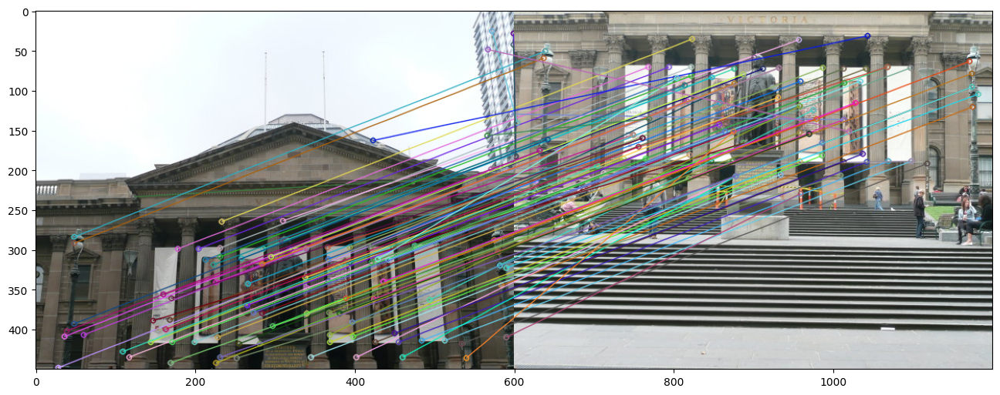

In [ ]:
# Show you result here
corner1 = feature_descript(getGreyImage(train_image), best_corners)
corner2 = feature_descript(getGreyImage(train_image2), best_corners2)
corner3 = feature_descript(getGreyImage(train_image3), best_corners3)
matches12 = feature_match(train_image, train_image2, corner1, corner2,0.8)
best_corners = np.array(best_corners)
sizes = np.ones(len(best_corners))
keypoints1 = []
for i in range(len(matches12)):#use best corners instead and use indices retunred by matches by changing matching function
    x = best_corners[matches12[i][0]][0]
    y = best_corners[matches12[i][0]][1]
    keypoints1.append(cv2.KeyPoint(float(x), float(y), 1.0))
keypoints2 = []
for i in range(len(matches12)):
    x = best_corners2[matches12[i][1]][0]
    y = best_corners2[matches12[i][1]][1]
    keypoints2.append(cv2.KeyPoint(float(x), float(y), 1.0))
Dmatches = []
for i in range(len(matches12)):
    queryIdx = i
    trainIdx = i
    Dmatches.append(cv2.DMatch(queryIdx, trainIdx, _imgIdx=0, _distance=1.0))

imMatches12 = cv2.drawMatches(train_image, keypoints1, train_image2, keypoints2, Dmatches, None)
plt.figure(figsize=(16,8))
plt.imshow(imMatches12, )

### 4. RANSAC for outlier rejection and to estimate Robust Homography: [20pts]


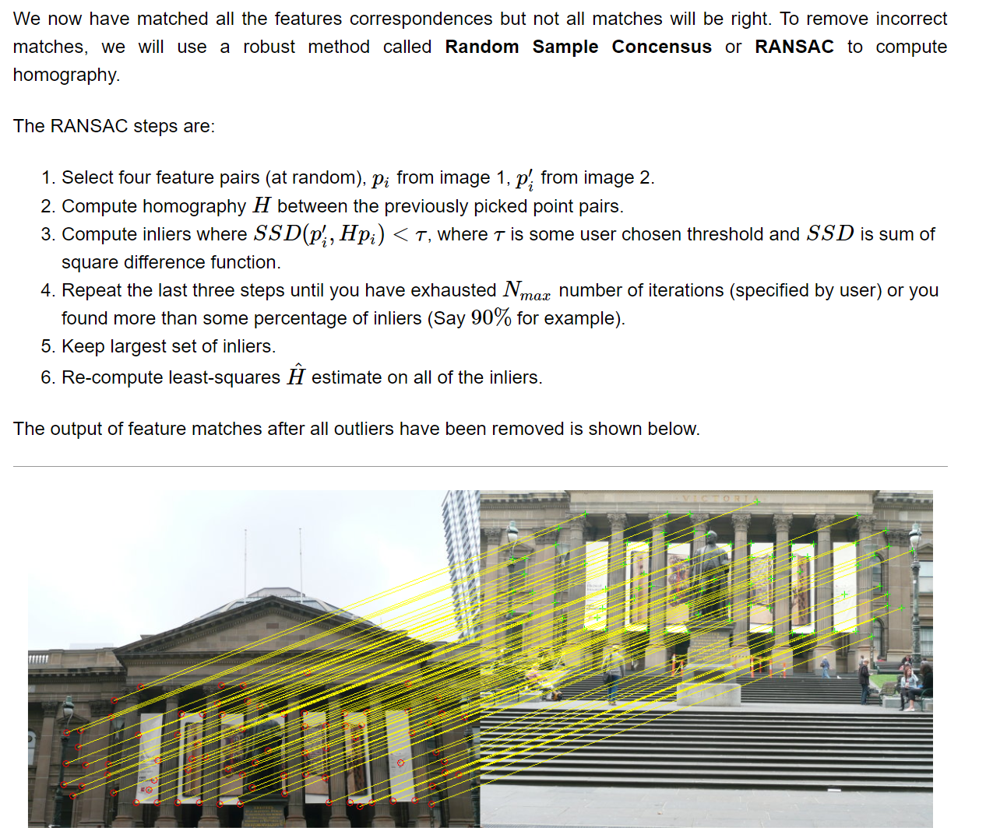

In [162]:
# Ransac to filter out the wrong matchings and return homography

import random

def fitH(inliers) :
  N = len(inliers)
  if N < 4 :
    print("four points needed")
    return
  A = np.zeros((2*N,8))
  b = np.zeros((2*N,1))
  for i in range(N) :
    x1 = inliers[i][0][0]
    y1 = inliers[i][0][1]
    x2 = inliers[i][1][0]
    y2 = inliers[i][1][1]

    b[2*i  ] = x2
    b[2*i+1] = y2
    #                 H11 H12 H13  H21 H22 H23  H31 H32
    A[2*i  ] = np.array([x1,y1,1, 0,0,0,   -x1*x2,-y1*x2])
    A[2*i+1] = np.array([0,0,0,   x1,y1,1, -x1*y2,-y1*y2])

  Ainv = np.linalg.pinv(A)
  h = np.dot(Ainv,b)
  # H33=1
  H = np.reshape(np.append(h,1.0),(3,3))

  return H

def RANSAC(match_kp1, match_kp2, N, t, threshold):
  max_inliers = 0
  inliers_biggest = []
  H_best = []
  for it in range(N):
    rand_4 = random.sample(range(len(match_kp1)), 4)
    kp1 =  [match_kp1[i] for i in rand_4]
    kp2 = [match_kp2[i] for i in rand_4]
    kp1 = np.float32(kp1)
    kp2 = np.float32(kp2)

    H = cv2.getPerspectiveTransform(kp1, kp2)
    inliers = []
    for point in range(len(match_kp1)):
      p1 = match_kp1[point]
      p2 = match_kp2[point]
      hpi = np.dot(H,[p1[0], p1[1],1])
      hpi = hpi/hpi[2]
      SSD = np.sum((hpi - [p2[0],p2[1],1])**2)
      if SSD<threshold:
        inliers.append((match_kp1[point],match_kp2[point]))
    if max_inliers<len(inliers):
      max_inliers = len(inliers)
      inliers_biggest = inliers
      H_best = H
    if len(inliers)>(t*len(match_kp1)):
      break

  src=np.array([inliers_biggest[i][0] for i in range(len(inliers_biggest))])
  dst=np.array([inliers_biggest[i][1] for i in range(len(inliers_biggest))])

  H_best = fitH(inliers_biggest)
  return inliers_biggest, H_best

In [152]:
def visMatches(img1,img2,inliers):
  keypoints10 = []
  for i in range(len(inliers)):
    x = inliers[i][0][0]
    y = inliers[i][0][1]
    keypoints10.append(cv2.KeyPoint(float(x), float(y), 1.0))
  keypoints20 = []
  for i in range(len(inliers)):
    x = inliers[i][1][0]  # Extract x coordinate
    y = inliers[i][1][1]  # Extract y coordinate
    keypoints20.append(cv2.KeyPoint(float(x), float(y), 1.0))
  Dmatches = []
  for i in range(len(inliers)):
    queryIdx = i
    trainIdx = i
    Dmatches.append(cv2.DMatch(queryIdx, trainIdx, _imgIdx=0, _distance=1.0))
  imMatches = cv2.drawMatches(img1, keypoints10, img2, keypoints20, Dmatches, None)
  plt.figure(figsize=(10, 10))
  plt.imshow(imMatches)
  plt.show()


thres= 50 n inliers= 62
using 62 points


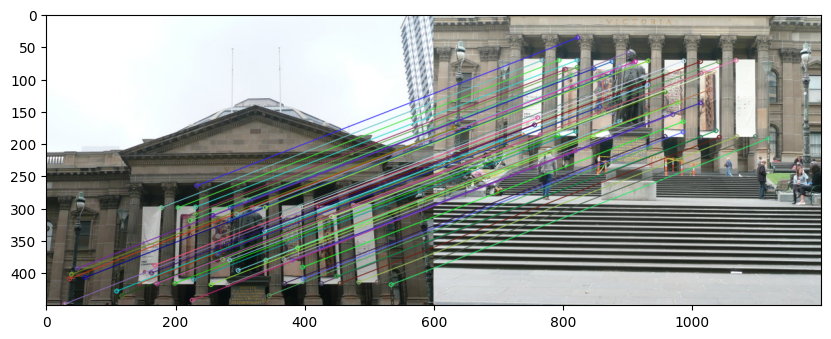

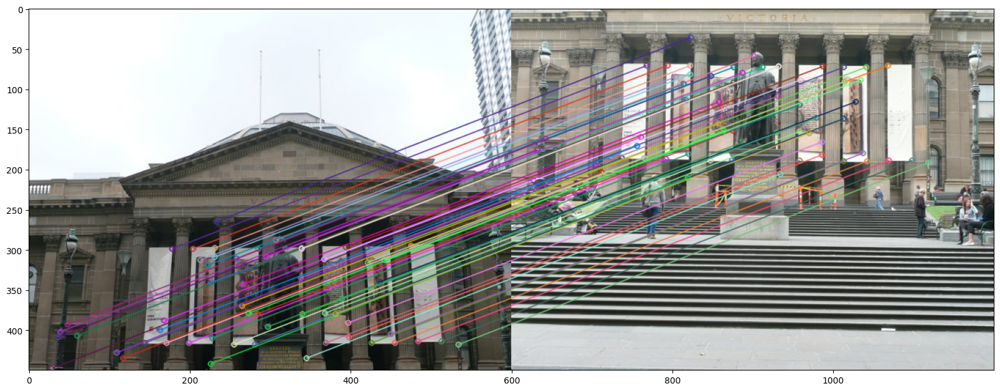

In [ ]:
# Show you result here
match_kp1 = []
match_kp2 = []
for i in range(len(keypoints1)):
  x1 = keypoints1[i].pt[0]
  y1 = keypoints1[i].pt[1]
  x2 = keypoints2[i].pt[0]
  y2 = keypoints2[i].pt[1]
  match_kp1.append([x1,y1])
  match_kp2.append([x2,y2])
inliers, H_best = RANSAC(match_kp1,match_kp2, 3000, 0.9, 50)

visMatches(train_image, train_image2,inliers)


#print(H_best)
#print(len(inliers))
keypoints10 = []
for i in range(len(inliers)):
    x = inliers[i][0][0]
    y = inliers[i][0][1]
    #print(matches[i])
    keypoints10.append(cv2.KeyPoint(float(x), float(y), 1.0))
keypoints20 = []
for i in range(len(inliers)):
    x = inliers[i][1][0]  # Extract x coordinate
    y = inliers[i][1][1]  # Extract y coordinate
    #print(x,y)
    keypoints20.append(cv2.KeyPoint(float(x), float(y), 1.0))
Dmatches = []
for i in range(len(inliers)):
    queryIdx = i
    trainIdx = i
    Dmatches.append(cv2.DMatch(queryIdx, trainIdx, _imgIdx=0, _distance=1.0))

imMatches = cv2.drawMatches(train_image, keypoints10, train_image2, keypoints20, Dmatches, None)
plt.figure(figsize=(20, 20))
plt.imshow(imMatches)

### 5. Image Warping (and Blending): [25pts]

Panorama can be produced by overlaying the pairwise aligned images to create the final output image. The output panorama stitched from two images shown in the figure below.

When blending these images, there are inconsistency between pixels from different input images due to different exposure/white balance settings or photometric distortions or vignetting. This can be resolved by [Poisson blending](http://www.irisa.fr/vista/Papers/2003_siggraph_perez.pdf). You can use third party code only for the seamless panorama stitching.

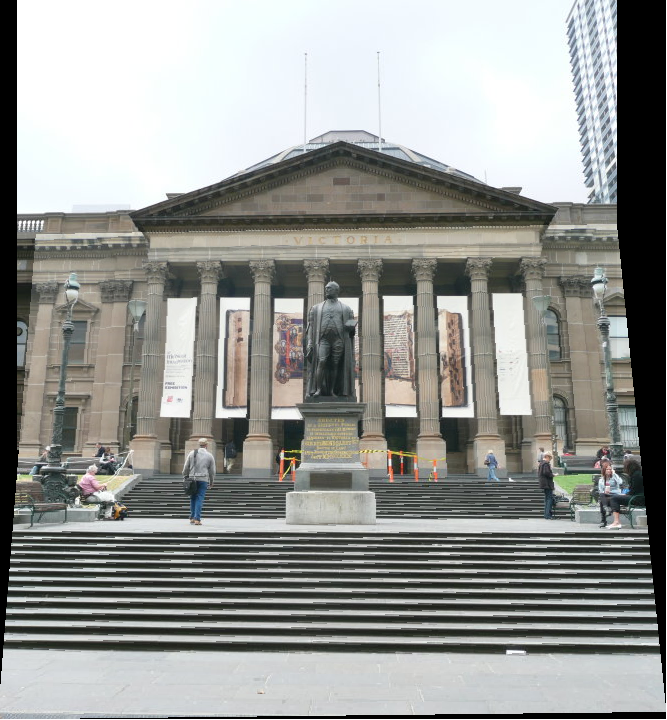

In [153]:
# Warp and Blend two images together based on Homography returned in RANSAC
def warp_and_blend(img2, img, H, offset):
  height,  width,  channels  = img.shape
  height2, width2, channels2 = img2.shape
  ll = [0,0,1]
  lr = [width-1,0,1]
  tl = [0,height-1,1]
  tr = [width-1, height-1,1]
  ll2 = np.dot(H,ll)
  ll2 = ll2/ll2[2]
  lr2 = np.dot(H,lr)
  lr2 = lr2/lr2[2]
  tl2 = np.dot(H,tl)
  tl2 = tl2/tl2[2]
  tr2 = np.dot(H,tr)
  tr2 = tr2/tr2[2]

  x_min = 10000
  if x_min > ll2[0]:
    x_min = ll2[0]
  if x_min > lr2[0]:
    x_min = lr2[0]
  if x_min > tr2[0]:
    x_min = tr2[0]
  if x_min > tl2[0]:
    x_min = tl2[0]
  x_max = -10000
  if x_max < ll2[0]:
    x_max = ll2[0]
  if x_max < lr2[0]:
    x_max = lr2[0]
  if x_max < tr2[0]:
    x_max = tr2[0]
  if x_max < tl2[0]:
    x_max = tl2[0]

  y_min = 10000
  if y_min > ll2[1]:
    y_min = ll2[1]
  if y_min > lr2[1]:
    y_min = lr2[1]
  if y_min > tr2[1]:
    y_min = tr2[1]
  if y_min > tl2[1]:
    y_min = tl2[1]
  y_max = -10000
  if y_max < ll2[1]:
    y_max = ll2[1]
  if y_max < lr2[1]:
    y_max = lr2[1]
  if y_max < tr2[1]:
    y_max = tr2[1]
  if y_max < tl2[1]:
    y_max = tl2[1]

  # limits
  ix_min = int(round(x_min)-1)
  ix_max = int(round(x_max)+1)
  iy_min = int(round(y_min)-1)
  iy_max = int(round(y_max)+1)

  if ix_min>offset[0]:
    ix_min=offset[0]
  if iy_min>offset[1]:
    iy_min=offset[1]
  if ix_max<width2+offset[0]:
    ix_max=width2+offset[0]
  if iy_max<height2+offset[1]:
    iy_max=height2+offset[1]

  width3  = ix_max - ix_min + 4
  height3 = iy_max - iy_min + 4
  print('orig',width3,height3)
  if width3 < width2+offset[0]-ix_min:
    width3 = width2+offset[0]-ix_min
  if height3 < height2+offset[1]-iy_min:
    height3 = height2+offset[1]-iy_min

  img3 = np.zeros((height3, width3, 3), dtype=np.uint8)
  img3[-iy_min+offset[1]:-iy_min+offset[1]+height2, -ix_min+offset[0]:-ix_min+offset[0]+width2] = img2

  for i in range(height):
    for j in range(width):
      p1 = [j,i,1]
      p1p = np.dot(H,p1)
      p1p = p1p/p1p[2]
      p2 = [p1p[0],p1p[1]]
      j2p = int(p2[0])
      i2p = int(p2[1])
      j2 = j2p-ix_min
      i2 = i2p-iy_min
      if 0<=i2 and i2<height3 and 0<=j2 and j2<width3:
        img3[i2,j2]=img[i,j]

  #plt.imshow(img3)
  offset = [ix_min,iy_min]
  return img3, offset

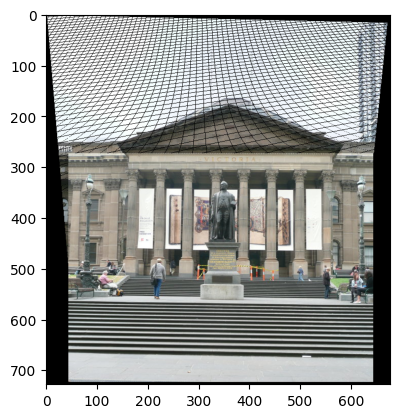

In [ ]:
# Show you result here
offset=[0,0]
img3,offset = warp_and_blend(train_image2,train_image, H_best,offset)

### 6. Putting Everything Together (Stitching more than 2 images)

In [158]:
# Take in a list of images and stitch them together!
def pano_imgs(img_list,limit=5000):
    # Step 1: Detect keypoints and features in each image using corner detection
    keypoints_list = []
    descriptors_list = []
    N = len(img_list)
    for img in img_list:
        # Convert to grayscale
        gray = getGreyImage(img)

        THRESH = 0.01
        img_corn, grey, corners = harris(img, THRESH,limit)
        best_corners = ANMS(grey, corners, num_best= 250)

        # Detect corners using goodFeaturesToTrack
        #corners = np.intp(cv2.goodFeaturesToTrack(gray, 1000, 0.01, 10))
        #corners = corners.reshape(-1, 2)

        #visualize_ANMS(img, best_corners)

        # Generate descriptors for the corners
        descriptors = feature_descript(grey, best_corners)

        keypoints_list.append(best_corners)
        descriptors_list.append(descriptors)

    # Step 2: Perform pairwise matching and estimate homography
    H_bests = np.zeros((N, 3,3))
    for i in range(1, N):

        img1 = img_list[i-1]
        img2 = img_list[i]
        corners1 = keypoints_list[i - 1]
        corners2 = keypoints_list[i]
        desc1 = descriptors_list[i - 1]
        desc2 = descriptors_list[i]

        # Match features between two images
        threshold = 0.8
        for tries in range(4):
          matches = feature_match(img1, img2, desc1, desc2,threshold)
          if(len(matches)>30):
            break
          threshold = threshold*1.1

        # Extract matched keypoints
        match_kp1 = [corners1[m[0]] for m in matches]
        match_kp2 = [corners2[m[1]] for m in matches]

        # Step 3: Use RANSAC to compute homography between img1 and img2
        Nit = 3000
        rat = 0.9
        thresh = 20
        for tries in range(4):
          inliers, H_best = RANSAC(match_kp1, match_kp2, Nit,rat,thresh) #1000, 0.8, 5)
          if(len(inliers)>25):
            break
          thresh = thresh*2

        H_bests[i-1] = H_best
        visMatches(img1,img2,inliers)

    # select last as anchor image
    # compute H to map to anchor image
    for i in range(N-3,-1,-1):
      print("Horig",H_bests[i])
      H_bests[i] = np.dot(H_bests[i+1],H_bests[i]);
      x=[0,0,1]
      x=np.dot(H_bests[i],x)
      x=x/x[2]

    # Step 4: Warp img2 to align with img1 based on the computed homography
    stitched_img = img_list[N-1]
    offset = [0,0]
    for i in range(N-2,-1,-1):
      stitched_img, offset = warp_and_blend(stitched_img, img_list[i], H_bests[i],offset)
      plt.imshow(stitched_img)
      plt.axis("off")
      plt.show()

    # Step 5: Display the final stitched panorama
    plt.imshow(stitched_img)
    plt.axis("off")
    plt.show()

    return stitched_img


set1:add image /content/train_images/Set1/1.jpg
set1:add image /content/train_images/Set1/2.jpg
set1:add image /content/train_images/Set1/3.jpg


<ipython-input-162-0e0d61290163>:48: RuntimeWarning: divide by zero encountered in divide
  hpi = hpi/hpi[2]
<ipython-input-162-0e0d61290163>:48: RuntimeWarning: invalid value encountered in divide
  hpi = hpi/hpi[2]


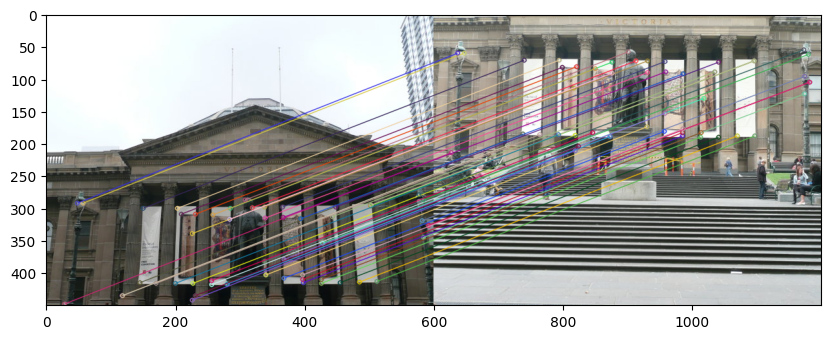

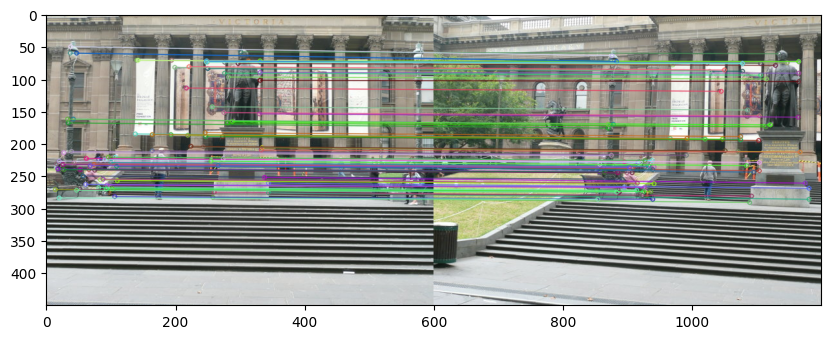

Horig [[ 1.11562151e+00  8.54849113e-02 -3.79990623e+01]
 [ 1.77194864e-02  1.15277542e+00 -2.70306601e+02]
 [ 8.58476726e-06  3.38259915e-04  1.00000000e+00]]
orig 897 526


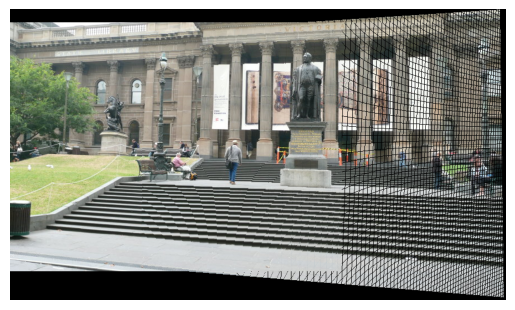

orig 924 828


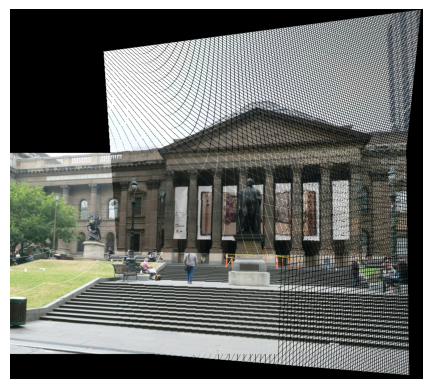

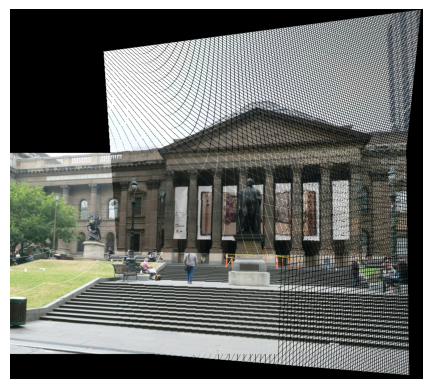

set2:add image /content/train_images/Set2/1.jpg
set2:add image /content/train_images/Set2/2.jpg
set2:add image /content/train_images/Set2/3.jpg


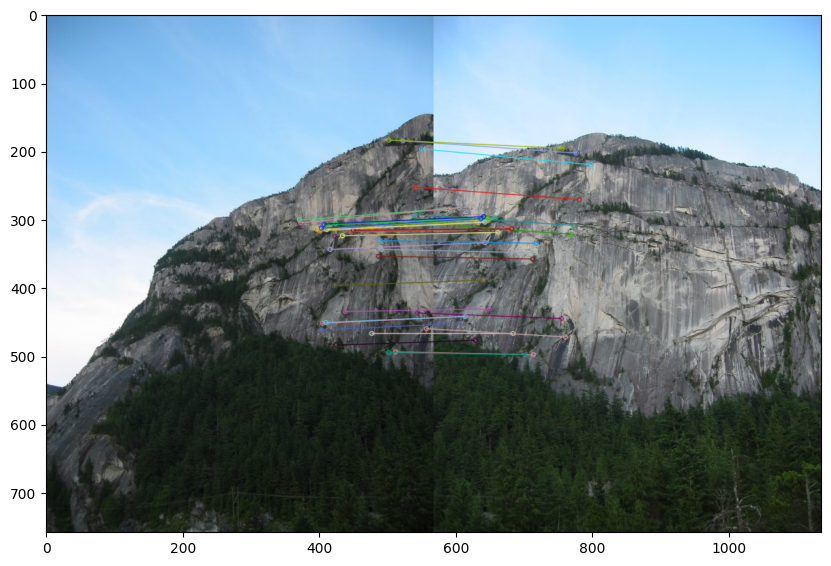

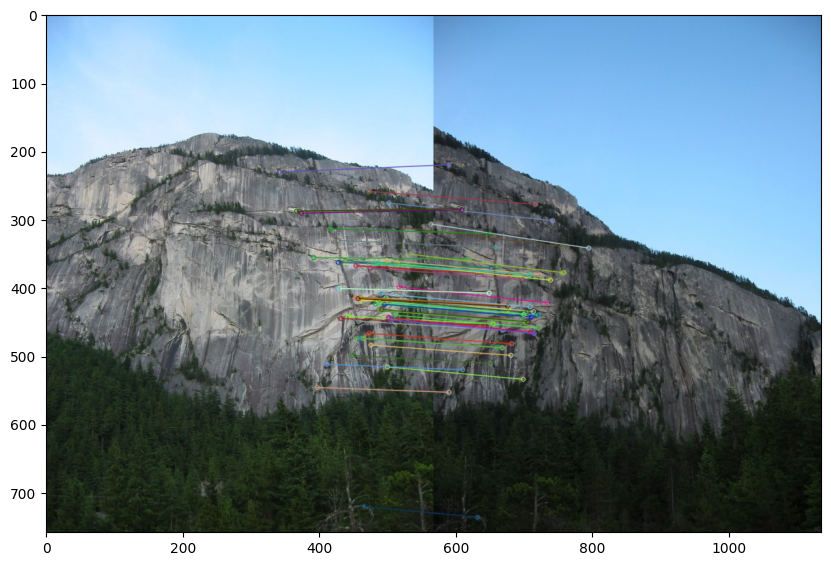

Horig [[ 1.23493801e+00 -2.13682911e-01 -3.52422410e+02]
 [ 3.76711651e-01  1.15133456e+00 -1.62536455e+02]
 [ 4.44275917e-04 -5.24815661e-05  1.00000000e+00]]
orig 1069 906


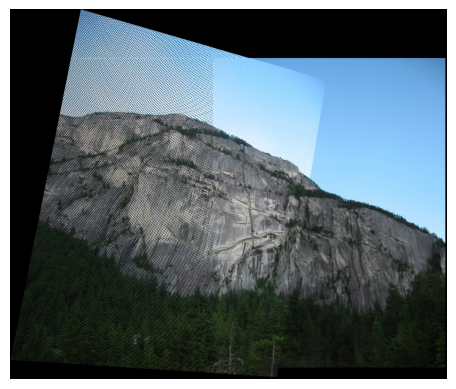

orig 1962 1249


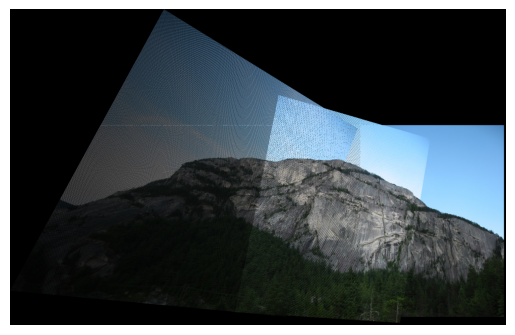

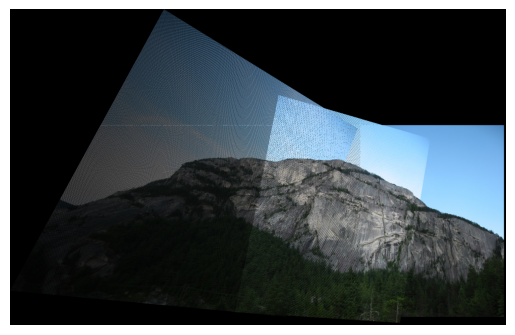

set3:add image /content/train_images/Set3/1.jpg
set3:add image /content/train_images/Set3/2.jpg
set3:add image /content/train_images/Set3/3.jpg
set3:add image /content/train_images/Set3/4.jpg
set3:add image /content/train_images/Set3/5.jpg
set3:add image /content/train_images/Set3/6.jpg
set3:add image /content/train_images/Set3/7.jpg
set3:add image /content/train_images/Set3/8.jpg


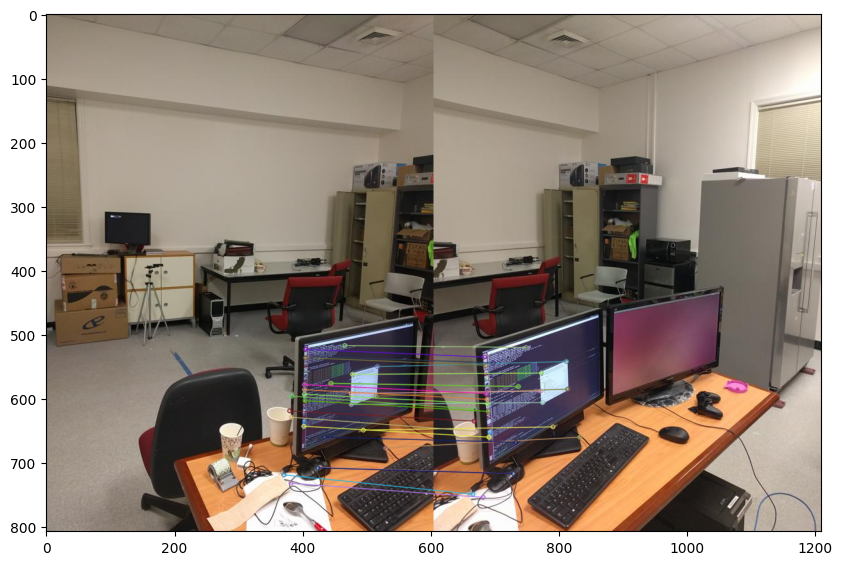

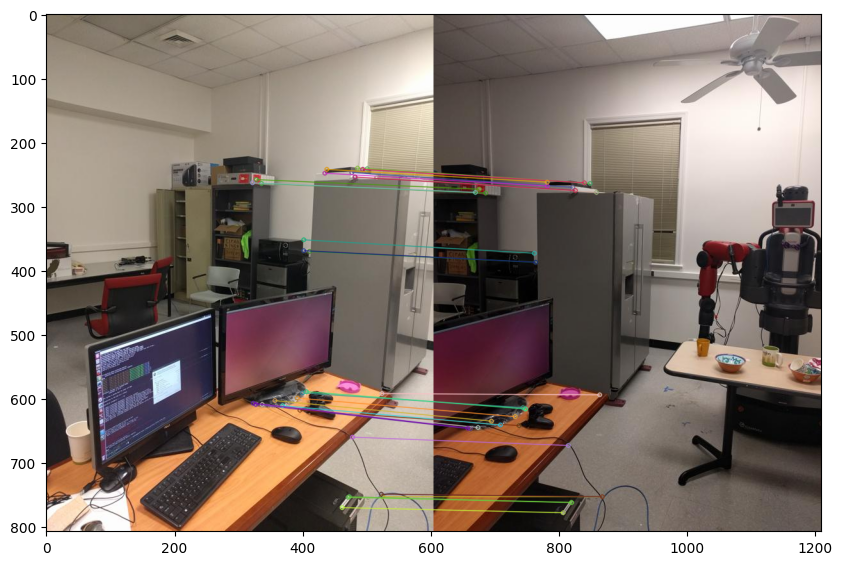

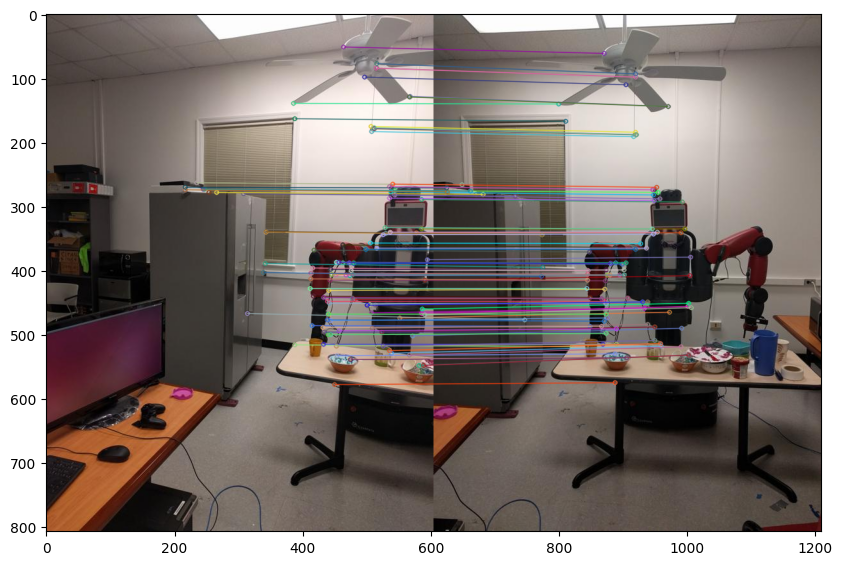

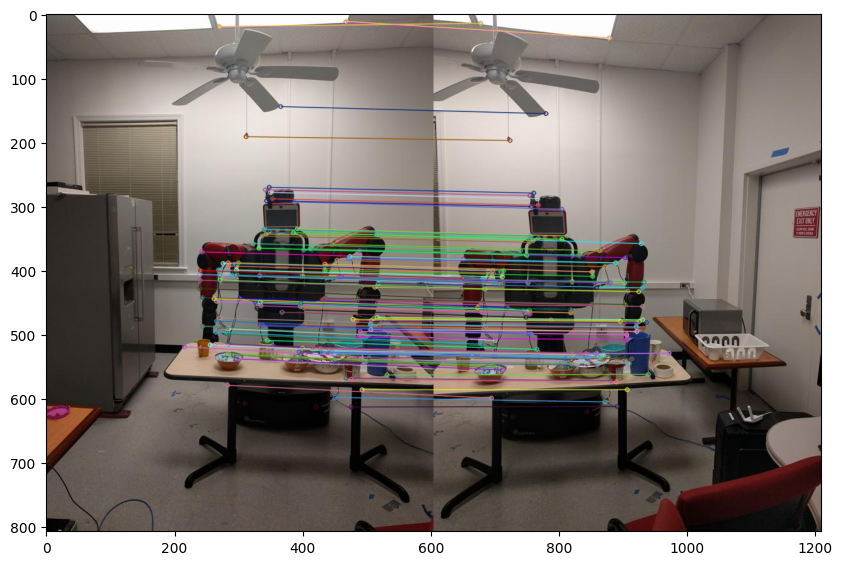

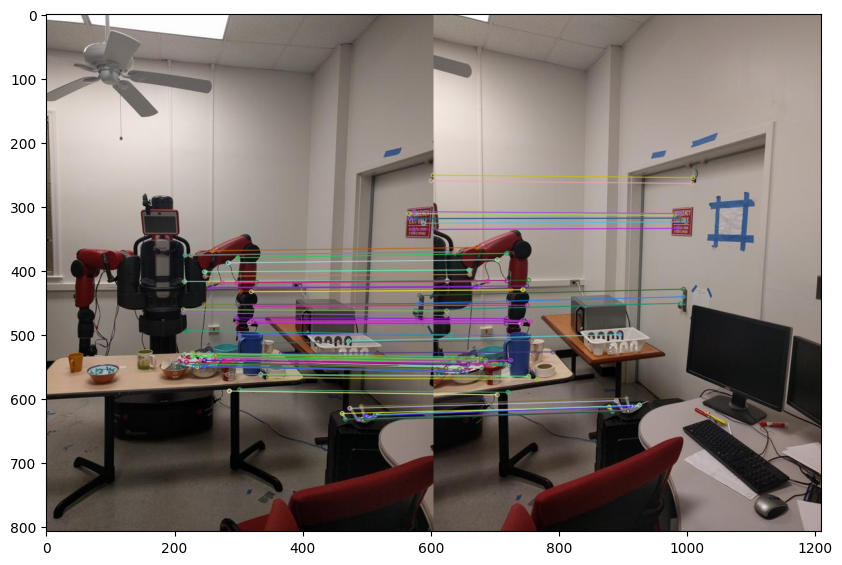

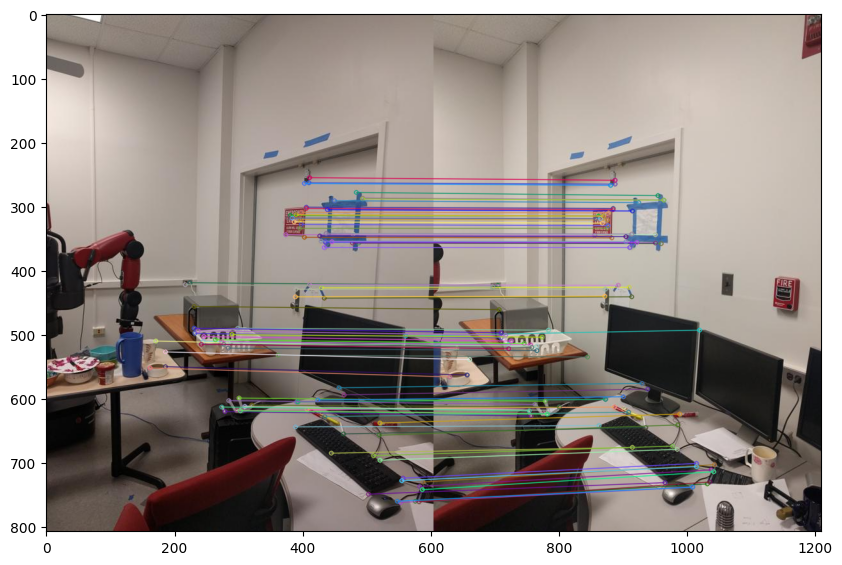

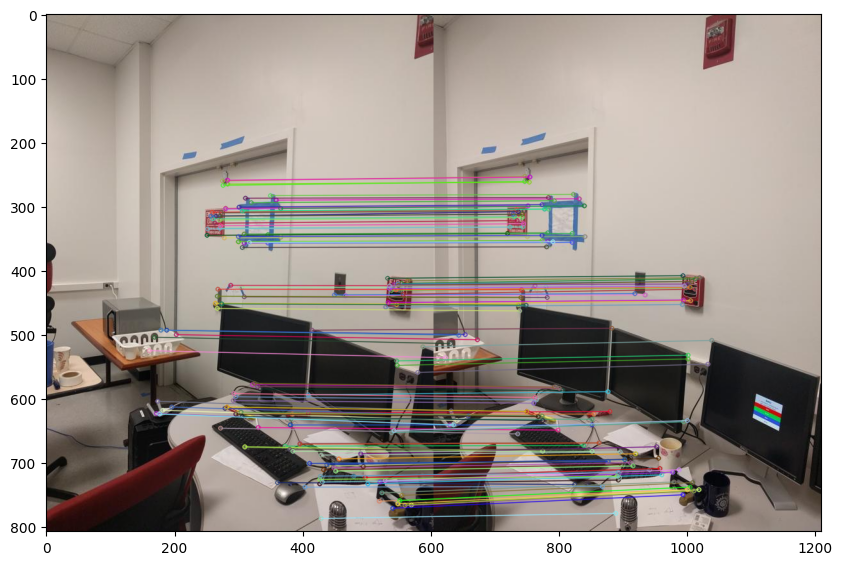

Horig [[ 1.19428119e+00 -1.99708325e-02 -1.52882512e+02]
 [ 1.54081916e-01  1.11863654e+00 -4.75484770e+01]
 [ 4.21683393e-04 -3.43912574e-05  1.00000000e+00]]
Horig [[ 1.29672379e+00 -3.92231257e-02 -2.40692529e+02]
 [ 1.93338299e-01  1.16990205e+00 -7.46487484e+01]
 [ 5.23048705e-04 -4.44782938e-05  1.00000000e+00]]
Horig [[ 1.27877257e+00  6.58756029e-03 -2.60670831e+02]
 [ 1.76135451e-01  1.17538044e+00 -5.30403481e+01]
 [ 4.85791634e-04 -1.44621933e-05  1.00000000e+00]]
Horig [[ 1.29485735e+00  6.74646071e-02 -2.72380629e+02]
 [ 1.52018104e-01  1.20432087e+00 -5.51280816e+01]
 [ 5.17447974e-04  4.71106735e-06  1.00000000e+00]]
Horig [[ 1.35243127e+00 -3.99898791e-02 -3.49696664e+02]
 [ 2.09465773e-01  1.17565274e+00 -4.31921202e+01]
 [ 6.75806351e-04 -1.20422178e-04  1.00000000e+00]]
Horig [[ 9.27894537e-01  5.55380430e-02 -3.34177466e+02]
 [-1.94411029e-01  6.95392920e-01  1.82980135e+02]
 [ 8.49358606e-07 -2.50643638e-04  1.00000000e+00]]
orig 790 925


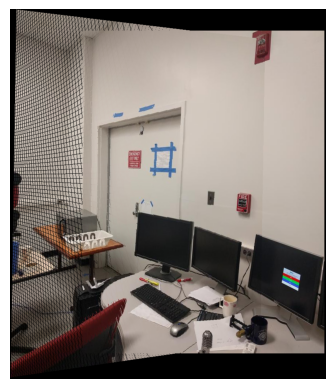

orig 1028 1129


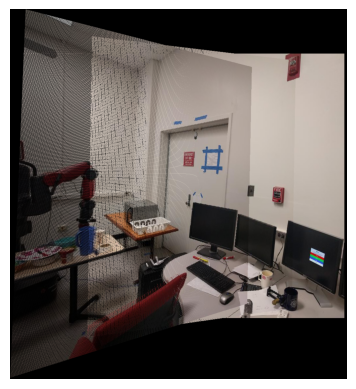

orig 1763 1808


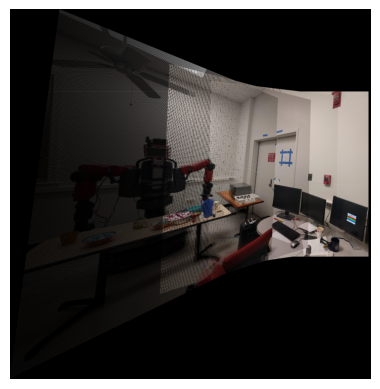

orig 5870 5692


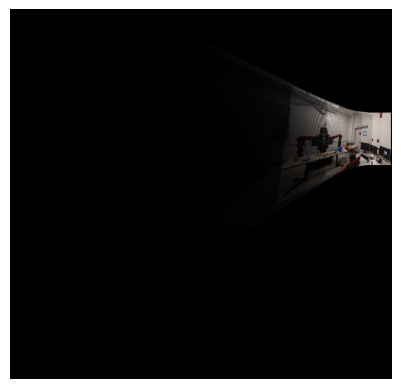

orig 10209 6913


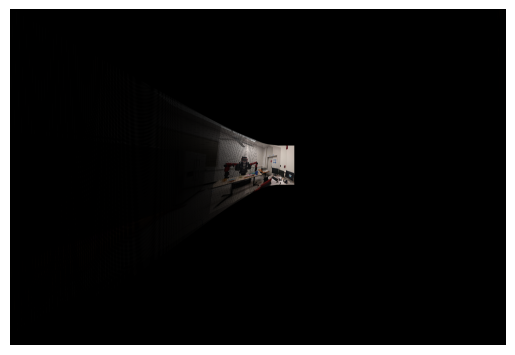

orig 10213 6917


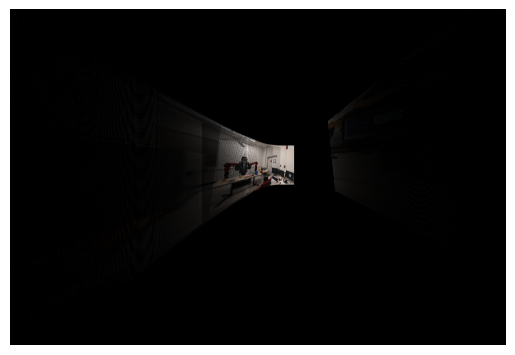

orig 20053 15001


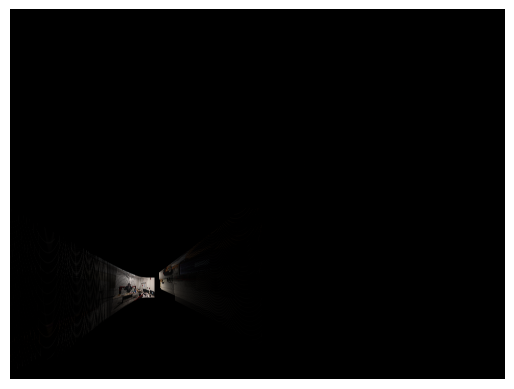

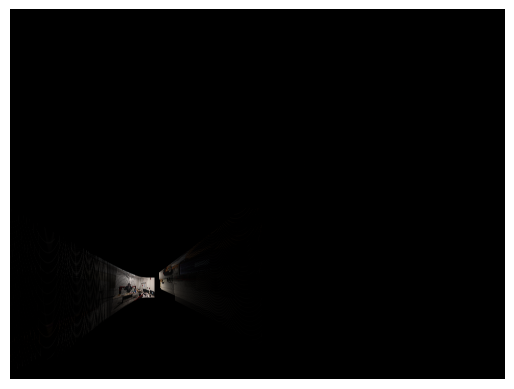

In [165]:

imgcnt = [3,3,8]

for idimg in range(0,3,1):
  img_list = []
  for i in range(imgcnt[idimg]):
    imgname = f"/content/train_images/Set{idimg+1}/{i+1}.jpg"
    print(f"set{idimg+1}:add image {imgname}")
    img_list.append(mpimg.imread(imgname))

  pano_imgs(img_list)


In [ ]:
imgcnt = [4,9,3]
limits = [300, 5000, 5000]
for idimg in range(1,3,1):
  img_list = []
  for i in range(imgcnt[idimg]):
    imgname = f"/content/test_images/TestSet{idimg+1}/{i+1}.jpg"
    print(f"set{idimg+1}:add image {imgname}")
    img_list.append(mpimg.imread(imgname))

  pano_imgs(img_list,limits[idimg])



set2:add image /content/test_images/TestSet2/1.jpg
set2:add image /content/test_images/TestSet2/2.jpg
set2:add image /content/test_images/TestSet2/3.jpg
set2:add image /content/test_images/TestSet2/4.jpg
set2:add image /content/test_images/TestSet2/5.jpg
set2:add image /content/test_images/TestSet2/6.jpg
set2:add image /content/test_images/TestSet2/7.jpg
set2:add image /content/test_images/TestSet2/8.jpg
set2:add image /content/test_images/TestSet2/9.jpg


## Report
You will be graded primarily based on your report.
A demonstration of understanding of the concepts involved in the project are required show the output produced by your code.

Include visualizations of the output of each stage in your pipeline (as shown in the system diagram on page 2), and a description of what you did for each step. Assume that we’re familiar with the project, so you don’t need to spend time repeating what’s already in the course notes. Instead, focus on any interesting problems you encountered and/or solutions you implemented.

Be sure to include the output panoramas for **all three image sets (from the trainingsets)**. Because you have limited time in which to access the “test set” images, we won’t expect in-depth analysis of your results for them.

As usual, your report must be full English sentences, **not** commented code. There is a word limit of 1500 words and no minimum length requirement.

 **TEST SET will be available 4 days before deadline: TBD on Piazza**

## To find the corners, we tried both the Harris and Shi-Tomasi methods. We found that the latter gave us well-spaced corners already, which didn't show off the ANMS properly since the points returned by ANMS were all the same ones. These methods returned the corners in different formats, which we also had to keep in mind.

##For the drawing matches function, we first had to transform the data so that we could input it into the drawMatches function. We first called the matches function using output from feature descript. We then looped through best corners from the output of ANMS and matches and populated the keypoints1 array with KeyPoint objects. We repeated this for keypoints2. To construct Dmatches, we looped through matches and made DMatch objects. We then called cv2.drawMatches on the images to visualize the matches.


##For the RANSAC function, we had to first transform our data so that we could pass it to the function. We extracted the keypoints from the KeyPoint objects and passed the array of points to the RANSAC function. We did the same for keypoints in the second image. In the function, we followed the instructions to get 4 random points and used perspectivetransform to get H. We used H to calculate hpi and SSD, we ran into some complications at this step, so it took some trial and error to get the proper method of calculation. For example, matrix multiplication and subtraction was somewhat difficult because the differences in shapes. After we found the largest set of inliers, the recalculation of H was especially difficult. We initially thought that we had to use the same perspective transform function to get the new H, however, that function only took in 4 points and we needed the H from all inliers, so we had to make our own function to calculate it. We did some online research to find formulas to calculate it, the website we used was (https://cseweb.ucsd.edu/classes/wi07/cse252a/homography_estimation/homography_estimation.pdf). We checked the outputted H against the findHomography function which we were not allowed to use to check accuracy.

##For warp and blend, we did not use the functions recommended, instead we warped and blended the images on our own. The first step was to try and blend only two images together with this function, so we used H to map pixels from the first image onto the second image. We did not account for the empty pixels so as a result the images have a netting on them and get darker as warping increases. This could be because we do not utilize the warp perspective function, however, the pictures line up and stitch nicely. Later on, when we had to consider stitching more than two images, we had to keep track of offset, because in the pano function, we based our algorithm on an anchor image as opposed to stitching recursively. We did that to avoid potentially getting bad corners and to ensure we applied corner detection to only the original images. We did not use poisson blending, however, the images do end up lining up for the most part.


##For the Pano function, each image in the img_list is first converted to grayscale using the getGreyImage() function. Grayscale is preferred for feature detection as it simplifies the image. Corners are detected in the grayscale image using the Harris corner detection method. After detecting corners, we apply ANMS (Adaptive Non-Maximal Suppression) to select the top 250 corners that are evenly distributed across the image. After selecting the best corners, descriptors for each of these keypoints are generated using the feature_descript() function. Descriptors describe the local neighborhood around each keypoint, allowing for better feature matching between images. Keypoints and descriptors for each image are stored in lists (keypoints_list and descriptors_list). As mentioned before, we have an anchor image which does not get warped, where all other images will map to it. We assume that the sequence of images is in an order such that there is an overlap between images. We obtain H by sequentially going through the set and getting the H from each image to the next. Then we then compute H from any image to the anchor image, which is done recursively. The algorithm worked well for the first two sets of the training set, but did not work as well with the last set because there was a greater number of images to stitch and because the mapping was complicated since the camera was rotating. The image also got significantly darker because of excessive stretching.
Train Image set, set 1 pano:


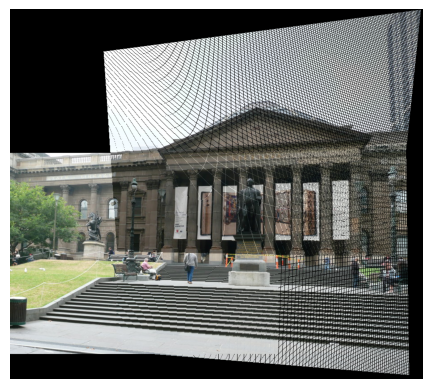



Train image set, set 2 pano:

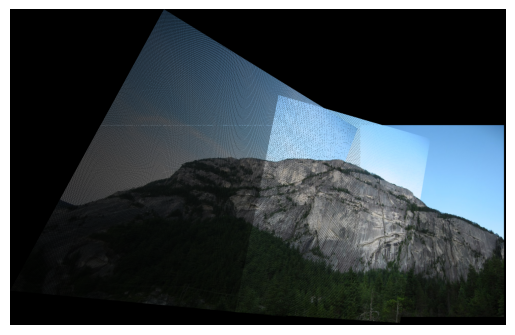



Train iamge set, set 3 pano:


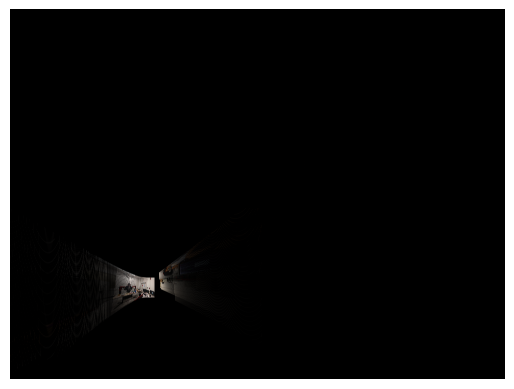

Test image set, set 1 pano: It ended up taking too long and I did not have time to output this file again for the report unfortunately. Although time saving measures were put into place such as reducing the threshold within the function if too many corners were detected in the initial detecting corners funciton.


Test image set, set 2 pano: It ended up taking too long and I did not have time to output this file again for the report unfortunately.



Test image set, set 3 pano:

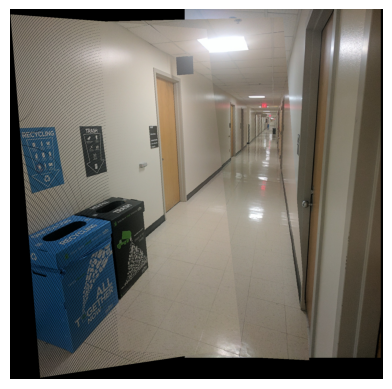





# Allowed Functions

For cv2 advanced functions, only these are allowed:
1. For feature detection: **cv2.cornerHarris**, **cv2.cornerHarris**
2. For drawing matches: **cv2.drawMatches**
3. For estimate homograhy and warping: **cv2.getPerspectiveTransform**, **cv2.warpPerspective**

# Submission Guidelines

**If your submission does not comply with the following guidelines, you’ll be given ZERO credit.**

Your submission on ELMS(Canvas) must be a pdf file, following the naming convention **YourDirectoryID_proj2.pdf**. For example, xyz123_proj2.pdf.

**All your results and report should be included in this notebook. After you finished all, please export the notebook as a pdf file and submit it to ELMS(Canvas).**

# Collaboration Policy
You are encouraged to discuss the ideas with your peers. However, the code should be your own, and should be the result of you exercising your own understanding of it. If you reference anyone else’s code in writing your project, you must properly cite it in your code (in comments) and your writeup. For the full honor code refer to the CMSC426 Fall 2023 website.